<a href="https://colab.research.google.com/github/kermityan/EPAM-DS-ML-Course-Notebooks/blob/main/Outliers_Detection_(Cardiotocography).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Outliers detection (Cardiotocography)

In this notebook, there is a solution for the task of detecting outliers in a cardiotocography dataset using unsupervised and supervised algorithms.

In [ ]:
! pip install pandas-profiling==3.2.0

In [ ]:
! pip install markupsafe==2.0.1

In [ ]:
%matplotlib inline

import numpy as np
import pandas as pd
import random
import warnings
warnings.filterwarnings('ignore')
from collections import Counter

from pandas_profiling import ProfileReport


from sklearn.decomposition import PCA
from sklearn.metrics import classification_report

from sklearn.decomposition import PCA
from sklearn.feature_selection import RFE

from sklearn.model_selection import  train_test_split
from sklearn.metrics import r2_score, fbeta_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler, MaxAbsScaler, RobustScaler, OneHotEncoder
from sklearn.preprocessing import QuantileTransformer
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC

from scipy.spatial.distance import pdist, mahalanobis, squareform
from scipy.stats import chi2
from sklearn.neighbors import LocalOutlierFactor
from sklearn.ensemble import IsolationForest
from sklearn.svm import OneClassSVM
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve

from imblearn.pipeline import Pipeline as imb_pipe
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

### Auxilary functions:

In [ ]:
def report(y_data, predictions, outlier_label = 1):
  predictions = predictions.copy()

  predictions[predictions != outlier_label] = 0
  predictions[predictions == outlier_label] = 1


  print(classification_report(y_data, predictions))
  print(f'F2-Score: {fbeta_score(y_data, predictions, beta=2.0):.2f}')

In [ ]:
def draw_hist(var):
  fig, ax = plt.subplots()
  ax.hist(df[var], bins=15, alpha=0.5, color="green")
  ax.set_xlabel(var)
  ax.set_ylabel("Count of experiments")
  #plt.ylim([0,100])
  title = var + " distribution"
  fig.suptitle(title)

  ax.legend();

In [ ]:
def roc_auc(estimator, X_test, y_test):
    logit_roc_auc = roc_auc_score(y_test, estimator.predict(X_test))
    fpr, tpr, thresholds = roc_curve(y_test, estimator.predict_proba(X_test)[:,1])
    plt.figure()
    plt.plot(fpr, tpr, label='Estimator (area = %0.2f)' % logit_roc_auc)
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic')
    plt.legend(loc="lower right")
    plt.show()

Mahalanobis distance functions:

In [ ]:
def is_pos_def(A):
    if np.allclose(A, A.T):
        try:
            np.linalg.cholesky(A)
            return True
        except np.linalg.LinAlgError:
            return False
    else:
        return False

def cov_matrix(data, verbose=False):
  # Returns covariance and inverse covariance matrices of given data
    covariance_matrix = np.cov(data, rowvar=False)
    if is_pos_def(covariance_matrix):
        inv_covariance_matrix = np.linalg.inv(covariance_matrix)
        if is_pos_def(inv_covariance_matrix):
            return covariance_matrix, inv_covariance_matrix
        else:
            print("Error: Inverse of Covariance Matrix is not positive definite!")
    else:
        print("Error: Covariance Matrix is not positive definite!")

def MahalanobisDist(inv_cov_matrix, mean_distr, data, verbose=False):
    # Returns Mahalanobis distances for given data, vector of means, and covarince matrix
    diff = data - mean_distr
    md = []
    for i in range(len(diff)):
        md.append(np.sqrt(diff[i].dot(inv_cov_matrix).dot(diff[i])))
    return md

def MD_detectOutliers(dist, extreme=False, verbose=False):
    # Receives the array of Mahalanobis distances, returns the array of outliers' indices
    threshold = MD_threshold(dist)
    outliers = []
    for i in range(len(dist)):
        if dist[i] >= threshold:
            outliers.append(i)  # index of the outlier
    return np.array(outliers)

def MD_threshold(dist, extreme=False, verbose=False):
    # Return threshold for finding outliers
    k = 3. if extreme else 2.
    #k = k * np.std(dist)
    threshold = np.mean(dist) * k
    return threshold

In [ ]:
def mah_dist(df):
    # Returns Mahalanobis distances for given dataframe

    cov, inv_cov = cov_matrix(df)
    mean_dist = df.mean(axis=0)

    m_dist = MahalanobisDist(inv_cov, mean_dist, df)

    return m_dist

Loading the data:

In [ ]:
df = pd.read_csv('/content/Cardiotocography.csv')

### EDA

In [ ]:
df.head().T

,0,1,2,3,4
id,1881.0,421.0,92.0,1767.0,1880.0
LB,0.592593,0.574074,0.777778,0.259259,0.592593
AC,0.0,0.038462,0.0,0.0,0.0
FM,0.0,0.0,0.0,0.0,0.001773
UC,0.294118,0.0,0.0,0.294118,0.294118
ASTV,0.633803,0.816901,0.774648,0.704225,0.633803
MSTV,0.338235,0.029412,0.029412,0.191176,0.352941
ALTV,0.0,0.527473,0.736264,0.0,0.0
MLTV,0.013807,0.092702,0.096647,0.183432,0.013807
DL,0.5,0.0,0.0,0.428571,0.428571


In [ ]:
df.shape

(16880, 23)

In [ ]:
df['id'] = df['id'].astype(int)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16880 entries, 0 to 16879
Data columns (total 23 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   id        16880 non-null  int64  
 1   LB        16880 non-null  float64
 2   AC        16880 non-null  float64
 3   FM        16880 non-null  float64
 4   UC        16880 non-null  float64
 5   ASTV      16880 non-null  float64
 6   MSTV      16880 non-null  float64
 7   ALTV      16880 non-null  float64
 8   MLTV      16880 non-null  float64
 9   DL        16880 non-null  float64
 10  DS        16880 non-null  float64
 11  DP        16880 non-null  float64
 12  Width     16880 non-null  float64
 13  Min       16880 non-null  float64
 14  Max       16880 non-null  float64
 15  Nmax      16880 non-null  float64
 16  Nzeros    16880 non-null  float64
 17  Mode      16880 non-null  float64
 18  Mean      16880 non-null  float64
 19  Median    16880 non-null  float64
 20  Variance  16880 non-null  fl

In [ ]:
df.outlier.value_counts()

b'no'     16550
b'yes'      330
Name: outlier, dtype: int64

I decided to replace the string values of the target variable with 0 and 1 values for the sake of simplicity:

In [ ]:
df['outlier'] = df['outlier'].replace("b'no'", 0)
df['outlier'] = df['outlier'].replace("b'yes'", 1)

In [ ]:
df.describe()

,id,LB,AC,FM,UC,ASTV,MSTV,ALTV,MLTV,DL,...,Min,Max,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency,outlier
count,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,...,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000,16880.000000
mean,1123.872156,0.483186,0.129270,0.011411,0.226668,0.425672,0.179521,0.064739,0.170819,0.113227,...,0.379411,0.365604,0.230579,0.033365,0.563887,0.525497,0.475086,0.090984,0.670794,0.019550
std,593.610901,0.175738,0.143077,0.060514,0.156665,0.216970,0.121198,0.146732,0.114551,0.171935,...,0.252147,0.153285,0.159211,0.069209,0.128429,0.136375,0.146790,0.119737,0.295171,0.138451
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,641.000000,0.351852,0.000000,0.000000,0.117647,0.236111,0.088235,0.000000,0.094675,0.000000,...,0.155963,0.258621,0.111111,0.000000,0.482143,0.431193,0.373494,0.015385,0.500000,0.000000
50%,1150.500000,0.481481,0.076923,0.000000,0.235294,0.408451,0.161765,0.000000,0.155819,0.000000,...,0.376147,0.353448,0.222222,0.000000,0.567797,0.525773,0.478261,0.045198,0.500000,0.000000
75%,1619.000000,0.592593,0.192308,0.003546,0.304348,0.608108,0.220588,0.050633,0.226824,0.214286,...,0.596330,0.456897,0.333333,0.000000,0.650000,0.621053,0.576087,0.122677,1.000000,0.000000
max,2126.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [ ]:
df.outlier.value_counts()

0    16550
1      330
Name: outlier, dtype: int64

Let's use ProfileReport to get deeper into given variables and their dependencies:

In [ ]:
profile = ProfileReport(df)

In [ ]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

As we can see most of the variables we have are numerical with a range between 0 and 1. Some of them have a distribution close to normal, while others (AC, FM, UC, MSTV, ALTV, MLTV, etc.) are skewed to the right. We also have 4 kinds of categorical variables - even though they have numeric values, the range of these values is discrete, and the number of different values is quite small. <br>
On the heatmap, we see that a few of the features are highly correlated with other features. Most of them are parameters of the histogram of some cardio-measures - Mean, Median, Mode, Variance, Min, Max, and Width. Probably I need to get rid of some of them later in order to reduce multicollinearity.

In [ ]:
df.id.value_counts()

1254    10
1433    10
1460    10
1459    10
1458    10
        ..
435      1
469      1
1950     1
300      1
942      1
Name: id, Length: 1902, dtype: int64

As per the output above we have from 1 to 10 rows with the same 'id' in the dataset. I suppose that these rows are different measures of the same person. This is also proved by the fact that all rows with the same id have the same target ('outlier') value (which actually means the presence or absence of a cardio disease)  

In [ ]:
df[df['outlier']==1]

,id,LB,AC,FM,UC,ASTV,MSTV,ALTV,MLTV,DL,...,Min,Max,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency,outlier
0,1881,0.592593,0.000000,0.000000,0.294118,0.633803,0.338235,0.000000,0.013807,0.500000,...,0.045872,0.336207,0.333333,0.1,0.485149,0.247423,0.284091,0.638418,1.0,1
1,421,0.574074,0.038462,0.000000,0.000000,0.816901,0.029412,0.527473,0.092702,0.000000,...,0.770642,0.672414,0.166667,0.0,0.534653,0.587629,0.511364,0.016949,0.0,1
2,92,0.777778,0.000000,0.000000,0.000000,0.774648,0.029412,0.736264,0.096647,0.000000,...,0.816514,0.275862,0.222222,0.0,0.633663,0.659794,0.602273,0.000000,1.0,1
3,1767,0.259259,0.000000,0.000000,0.294118,0.704225,0.191176,0.000000,0.183432,0.428571,...,0.174312,0.275862,0.222222,0.1,0.000000,0.164948,0.000000,0.361582,0.0,1
4,1880,0.592593,0.000000,0.001773,0.294118,0.633803,0.352941,0.000000,0.013807,0.428571,...,0.045872,0.336207,0.333333,0.1,0.485149,0.226804,0.272727,0.683616,1.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15220,1792,0.277778,0.000000,0.001773,0.235294,0.720000,0.279412,0.000000,0.126233,0.785714,...,0.045872,0.327586,0.388889,0.0,0.000000,0.110092,0.000000,0.615819,0.0,1
15221,198,0.722222,0.000000,0.000000,0.117647,0.493333,0.058824,0.037975,0.228797,0.000000,...,0.825688,0.387931,0.000000,0.0,0.766667,0.761468,0.702128,0.016949,1.0,1
15222,942,0.555556,0.038462,0.000000,0.294118,0.653333,0.044118,0.607595,0.157791,0.000000,...,0.678899,0.284483,0.500000,0.0,0.625000,0.614679,0.521277,0.011299,0.5,1
15223,1446,0.759259,0.000000,0.000000,0.294118,0.480000,0.058824,0.658228,0.102564,0.000000,...,0.908257,0.387931,0.111111,0.0,0.775000,0.779817,0.712766,0.000000,0.5,1


If we explore any of the blocks of rows with the same id we will see that some of the features have the same value (which is somehow constant for the same person) but other features have different values, so that might be different measurements.

In [ ]:
df[df['id']==	1446.0]

,id,LB,AC,FM,UC,ASTV,MSTV,ALTV,MLTV,DL,...,Min,Max,Nmax,Nzeros,Mode,Mean,Median,Variance,Tendency,outlier
6755,1446,0.759259,0.0,0.0,0.294118,0.500000,0.058824,0.619048,0.102564,0.0,...,0.908257,0.387931,0.111111,0.0,0.787402,0.752577,0.674699,0.0,0.5,1
13525,1446,0.759259,0.0,0.0,0.294118,0.507042,0.058824,0.619048,0.102564,0.0,...,0.908257,0.387931,0.111111,0.0,0.732673,0.747368,0.703297,0.0,0.5,1
15223,1446,0.759259,0.0,0.0,0.294118,0.480000,0.058824,0.658228,0.102564,0.0,...,0.908257,0.387931,0.111111,0.0,0.775000,0.779817,0.712766,0.0,0.5,1


In [ ]:
target = 'outlier'

features = list(df.columns)
features.remove(target)

In [ ]:
outliers = df[df[target]==1]['id']

Blocks of the rows with the positive target value (outliers) never have more than 3 rows (measurements) in them:  

In [ ]:
outliers.value_counts()

348     3
534     3
1215    3
1685    3
2027    3
       ..
599     1
1414    1
825     1
374     1
942     1
Name: id, Length: 247, dtype: int64

Let's plot dual boxplots for both negative and positive target outcomes to get an understanding of which features correlate more with the target:

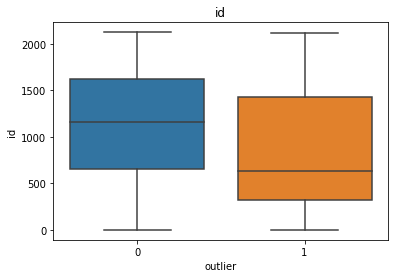

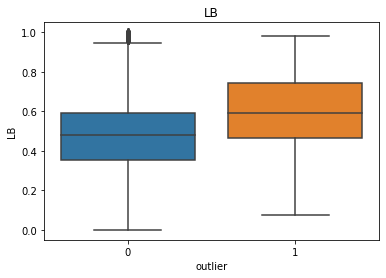

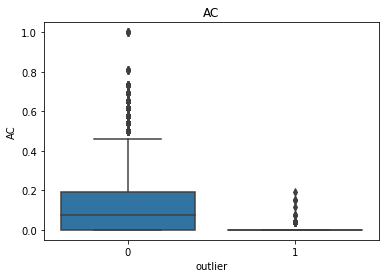

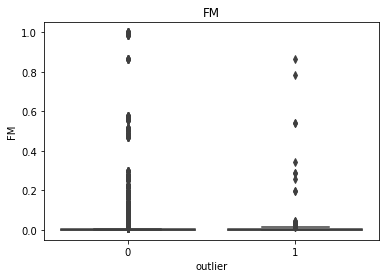

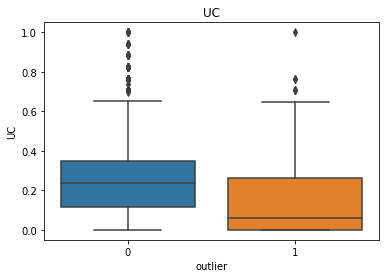

...

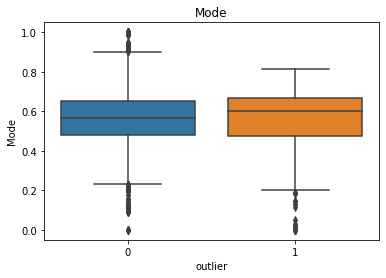

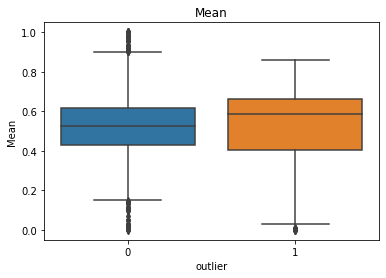

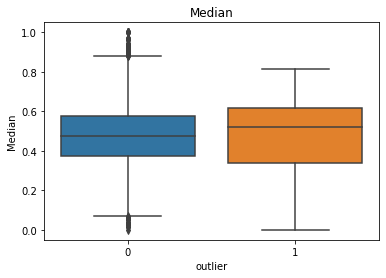

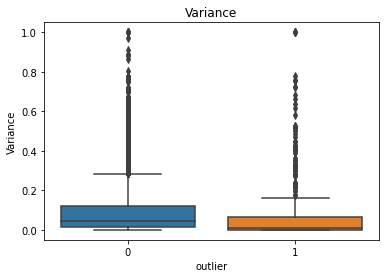

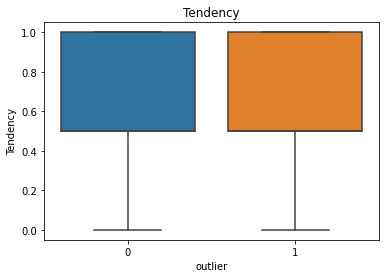

In [ ]:
for feature in features:
    plt.figure()
    sns.boxplot(y = feature, x=target, data=df, )
    plt.title(feature)

We can see that some of the features have different distributions in positive and negative cases (ALTV, ASTV, UC, MSTV, DL), and others - are more or less similarly distributed in both cases. I suppose that the first group has a higher impact on the target variable than the second. So this fact can be used somehow in further analysis.

### Feature Engineering

I decided to use QuntileTransformer for all features in order to transform data to normal distribution:

In [ ]:
quantile_transformer = QuantileTransformer(random_state=42,  output_distribution='normal')
transformed = quantile_transformer.fit_transform(df)

In [ ]:
df_transformed = pd.DataFrame(transformed, columns=df.columns)

I also tried to use PolinomialFeatures for some features (ALTV, ASTV) assuming that this could increase their impact on the final distribution of the data and improve the outcome of outlier detection algorithms, but this hasn't given any significant result. I assume that I probably haven't used it in a proper way or haven't found the right features to apply Polynomial to. <br>
So the following block of cells I leave for informative reasons but it actually doesn't use in the further pipeline.

In [ ]:
features_to_transform = ['ALTV']

In [ ]:
pf = PolynomialFeatures(degree=2)
polynom_data = pf.fit_transform(df[features_to_transform])
polynom_data

array([[1.        , 0.        , 0.        ],
       [1.        , 0.52747253, 0.27822727],
       [1.        , 0.73626374, 0.54208429],
       ...,
       [1.        , 0.34177215, 0.1168082 ],
       [1.        , 0.21518987, 0.04630668],
       [1.        , 0.4556962 , 0.20765903]])

In [ ]:
df_poly = pd.DataFrame(polynom_data, columns=['poly1', 'poly2', 'poly3'])

In [ ]:
df_transformed = pd.concat([df_transformed, df_poly], axis=1)

/////// Not used code ends here //////////

Assigning X and y, according to established standards:

In [ ]:
X = df_transformed.drop('outlier', axis=1)
y = df[target]

In [ ]:
X.T

,0,1,2,3,4,5,6,7,8,9,...,16870,16871,16872,16873,16874,16875,16876,16877,16878,16879
id,1.202864,-1.029569,-1.733876,0.943324,1.201830,-1.099130,-1.108214,1.689017,-1.102127,-0.537289,...,2.553085,2.575483,2.611712,2.651732,2.747453,2.806711,2.877846,2.967430,3.089935,5.199338
LB,0.598435,0.489307,1.738731,-1.391202,0.598435,0.783330,0.869846,-0.326900,0.489307,0.869846,...,0.395204,0.395204,0.489307,0.783330,0.783330,0.783330,0.783330,0.783330,0.783330,0.975466
AC,-5.199338,-0.345485,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,...,-5.199338,-5.199338,-5.199338,-5.199338,-0.345485,-5.199338,-5.199338,-5.199338,-5.199338,-0.345485
FM,-5.199338,-5.199338,-5.199338,-5.199338,0.486480,1.446104,1.207532,0.486480,1.566990,0.697507,...,0.851675,0.486480,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,0.486480
UC,0.507774,-5.199338,-5.199338,0.507774,0.507774,-5.199338,-5.199338,1.179402,-5.199338,-5.199338,...,0.160010,0.160010,0.866189,-0.208505,-1.002056,0.866189,1.179402,0.866189,0.160010,0.507774
ASTV,0.805692,1.918441,1.750222,1.233962,0.805692,2.408550,1.976943,1.679303,1.460531,2.303707,...,1.090995,1.501861,2.470375,2.771556,2.365719,2.262072,2.262072,2.262072,2.119668,1.961402
MSTV,1.321946,-1.994971,-1.994971,0.344154,1.381364,-5.199338,-1.994971,1.529558,-1.620592,-5.199338,...,1.100140,0.344154,-1.994971,-5.199338,-5.199338,-2.386340,-1.620592,-1.280981,-1.002056,-1.994971
ALTV,-5.199338,1.903487,2.456904,-5.199338,-5.199338,3.097101,2.456904,-5.199338,1.033647,2.274857,...,-5.199338,1.055293,1.674355,2.074445,1.761948,1.340200,1.474767,1.492579,1.264985,1.761948
MLTV,-1.529558,-0.687939,-0.639462,0.293986,-1.529558,-0.926176,0.601439,-5.199338,0.618059,-0.779924,...,-0.616541,-0.687939,-0.360172,-0.532190,-1.179402,0.138444,-0.189310,-0.332198,-0.407442,-0.616541
DL,1.761948,-5.199338,-5.199338,1.501861,1.501861,-5.199338,-5.199338,1.501861,-5.199338,-5.199338,...,1.223287,-5.199338,-5.199338,-5.199338,-5.199338,-5.199338,0.307111,0.307111,0.307111,-5.199338


Here I define columns to drop. I experimented with this a lot, using different combinations and checking the results of algorithms. Here is the set that give the best results:

In [ ]:
columns_to_drop = ['id', 'Mode', 'Width', 'Min', 'Max', 'Nmax', 'DS', 'Tendency', 'Nzeros']

In [ ]:
X_pca = X.drop(columns_to_drop, axis=1)

For the transformation pipeline, I chose StandardScaler and PCA with 3 components - in order to have an opportunity to visualize data and results of the algorithms:

In [ ]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_pca)

pca = PCA(n_components=3)
x_reduced = pca.fit_transform(X_scaled)
pca.explained_variance_ratio_.sum()


0.5679558481440123

In [ ]:
X_scaled_df = pd.DataFrame(X_scaled, columns=X_pca.columns)

In [ ]:
fig = px.scatter_3d(x_reduced, x=x_reduced[:,0], y=x_reduced[:,1], z=x_reduced[:,2],
              color=y)
fig.show()

Here is a 3d visualization of the data I got from previous features engineering and transformations. As we see most of the outliers are concentrated in two areas out of the main most dense area of the data. But I couldn't manage to divide them fully - there are overlapping areas where a big number of outliers are mixed with the normal data points. I believe that some additional feature transformation or engineering could improve this picture of data distribution and respectively it might improve the results of outliers detection models drastically.

### Mahalanobis Distance

First method I am going to use to detect outliers is a Mahalanobis distance. <br>

This metric takes into account the distribution of samples. Here is the formula:
> $D_M(x,y) ^2 = (x-y)^T * C^{-1} * (x - y)$, where x, y - vectors of to measure distance and $ C^{-1}$ - inverse covariance matrix of data.

This metric rotates coordinate system to remove correlations between axes and scales to make dispersion by each axis equal to 1.

Aferward we can measure distance between samples and center of data and provide chi-square test to detect outliers:
> $\chi_n ^2 (x) = D_M(x, m)^2 = (x - m)^T * C^{-1} * (x - m)$  where m - mean vector of data, n - data dimensionality. <br>
$p\_value = 1 - \chi_{1-\alpha} ^2 (n)$



Getting Mahalanobis distances between all data points and the center of the data cluster (using previously prepared function):

In [ ]:
dist = mah_dist(x_reduced)

Getting the threshold for identifying outliers:

In [ ]:
thresh = MD_threshold(dist)
thresh

3.191837134054141

Getting the array of outliers IDs according to Mahalanobis distance:

In [ ]:
predict_ol = MD_detectOutliers(dist)

In [ ]:
predict_ol

array([    3,     4,     5,     7,     9,    10,    11,    16,    18,
          19,    22,    24,    27,    28,    29,    31,   224,   342,
         343,   713,  1071,  1270,  1271,  1272,  1273,  1314,  1315,
        1317,  1318,  1395,  1593,  1594,  1606,  1607,  1608,  1609,
        1653,  1654,  1671,  1676,  1677,  1678,  1681,  1688,  1689,
        1691,  1692,  1697,  1698,  1699,  1700,  1704,  1705,  1706,
        1707,  1712,  1713,  1714,  1717,  1719,  1912,  2030,  2031,
        2401,  2958,  2959,  2960,  2961,  3006,  3083,  3281,  3282,
        3341,  3342,  3359,  3365,  3369,  3376,  3381,  3382,  3383,
        3390,  3391,  3394,  3396,  3402,  3406,  3408,  3600,  3718,
        3719,  4089,  4408,  4447,  4646,  4647,  4648,  4649,  4690,
        4691,  4693,  4694,  4706,  4771,  4969,  4970,  4976,  4977,
        4978,  4982,  4983,  4984,  4985,  5005,  5029,  5030,  5047,
        5052,  5053,  5054,  5057,  5064,  5067,  5068,  5076,  5083,
        5085,  5086,

In [ ]:
len(predict_ol)

371

Getting an array of predictions (0 - normal data, 1 - outlier):

In [ ]:
predictions = np.zeros(x_reduced.shape[0])
for i in predict_ol:
  predictions[i]=1

Comparing predictions with the ground truth. Getting the number of matches:

In [ ]:
k=0
for i in predict_ol:
  if y[i] == predictions[i]:
    k+=1
print(k)

129


Visualization of the predictions we got:

In [ ]:
fig = px.scatter_3d(x_reduced, x=x_reduced[:,0], y=x_reduced[:,1], z=x_reduced[:,2],
              color=predictions)
fig.show()

As we can see this algorithm marked as outliers all the points that are beyond a certain radius from the center of the data cluster. And it obviously misses all the outliers lying in the mixed zones.

In [ ]:
report(y, predictions)

              precision    recall  f1-score   support

           0       0.99      0.99      0.99     16550
           1       0.35      0.39      0.37       330

    accuracy                           0.97     16880
   macro avg       0.67      0.69      0.68     16880
weighted avg       0.98      0.97      0.97     16880

F2-Score: 0.38


#### Metrics choice:

For the medical application which we deal with, where it is crucial not to miss patients having a disease, I assume the most appropriate metric should be the recall for the positive case (as it reflects the False Negatives rate) and F2-score as it reflects both precision and recall but with more weight to recall. <br>
In the case of the Mahalanobis distance method, we got the recall = 0.39 and F2 = 0.38.

### Local Outlier Factor

Next unsupervised method of detecting outliers I use is Local Outlier Factor. This method based on dencities of data points. Here is a short theoretical explanation of it:

> r(x,y) - metric of distance between points. <br>
$k-distance = r(x,x_k)$ - distance between x and k nearest neighbor x_k <br>
$reachability-distance(x,y) = max\{k-distance(y), r(x,y)\}$ <br>
$lrd_k(x) = 1/(\frac{\sum_{y \in N_k(x)} reachability-distance(x,y)}{|N_k(x)|})$ - local reachability density, where $N_k(x)$ - set of k nearest neighbors. This tells how far a point is from the nearest cluster of points. Low values of LRD implies that the closest cluster is far from the point. <br>

$LOF_k(x) = \frac{\sum_{y \in N_k(x)}(lrd(y))}{|N_k(x)|} / lrd(x)$ - fraction of mean LRDs of neighbors and sample's LRD. The LRD of each point will then be compared to the LRD of their k neighbors. The LOF is basically the average ratio of the LRDs of the neighbors of a to the LRD of the point A. If the ratio is greater than 1, the density of point A is on average smaller than the density of its neighbors and, thus, from point A, we have to travel longer distances to get to the next point (or cluster) than from A’s neighbors to their next neighbors. <br>
If LOF ~ 1 => point density comparable to neighbors' => point is not an outlier. <br>
If LOF >> 1 => point density much less than neighbors' => point is an outlier.

Defining a model and getting predictions:

In [ ]:
lof_model = LocalOutlierFactor(n_neighbors=250, contamination=.07)

The hyperparameters values I use were found empirically by hand. Using GridSearchCV (code is a few cells below) unfortunately didn't give proper results, perhaps I should have used a different metric. I assumed that I can use the contamination parameter which is a ratio of the number of outliers to the number of normal data even though we actually know this ratio (0.02) but in real life we couldn't have this information the most of cases. I assumed that I could estimate this percentage roughly as 1 to 10% and then manually get through some of values in this interval and get the optimal value.

In [ ]:
lof_predictions = lof_model.fit_predict(x_reduced)

In [ ]:
fig = px.scatter_3d(x_reduced, x=x_reduced[:,0], y=x_reduced[:,1], z=x_reduced[:,2],
              color=lof_predictions)
fig.show()

As we can see on the 3d plot the LOF algorithm marks as outlies points on the periphery of the data cluster where their local densities are much lower than the densities of points that lie closer to the center of the cluster.

In [ ]:
report(y, lof_predictions, outlier_label=-1)

              precision    recall  f1-score   support

           0       0.99      0.94      0.96     16550
           1       0.13      0.47      0.21       330

    accuracy                           0.93     16880
   macro avg       0.56      0.71      0.58     16880
weighted avg       0.97      0.93      0.95     16880

F2-Score: 0.31


And again we can see not a very good result in terms of chosen metrics. Even though the recall is higher than in the Mahalanobis case, precision at the same time is much lower (that means that it marked as outliers a lot of good points) so F2-score is lower too. <br> Recall = 0.47, F2-score = 0.31

This GridSearchCV code seems not working well. It's gave simply the first of parameters combinations. Probably there is some mistake there, but I had no time to debug it. TBD

In [ ]:
def lof_hypers():
  n_neighbors = list(range(100,300,10))
  contamination = ['auto', 0.02, 0.03, 0.05, 0.07, 0.09]

  #Convert to dictionary
  #leaf_size=leaf_size, p=p
  hyperparameters = dict(n_neighbors=n_neighbors, contamination=contamination)
  #Create new KNN object
  lof = LocalOutlierFactor()
  #Use GridSearch
  clf = GridSearchCV(lof, hyperparameters, cv=5, scoring='f1_score')
  #Fit the model
  best_model = clf.fit(x_reduced)
  #Print The value of best Hyperparameters
  print('Best n_neighbors:', best_model.best_estimator_.get_params()['n_neighbors'])
  print('Best contamination:', best_model.best_estimator_.get_params()['contamination'])
  return best_model
best_lof = lof_hypers()

Best n_neighbors: 100
Best contamination: auto


### Isolation Forest

Next unsupervized algorithm I tested was Isolation Forest - tree-based algorithm for detecting rare points.
The principle isolation forest works on is that outliers are points with features that are considerably different than the rest of the data, the inliers.
Intuition: if a random decision tree cuts off the point earlier than others - this point can be considered as outlier.

After training a forest we calculate a measure of sample anomality as a mean length of paths in all trees.
If this score is less than some threshold => it is an outlier.

In [ ]:
iso_forest = IsolationForest(n_estimators=100, contamination=0.05)

Again here I selected a combination of the parameters manually because I didn't have enought time to sort out how parameters evaluating tools work with unsupervised algorithms.  TBD

In [ ]:
iso_predictions = iso_forest.fit_predict(x_reduced)

In [ ]:
fig = px.scatter_3d(x_reduced, x=x_reduced[:,0], y=x_reduced[:,1], z=x_reduced[:,2],
              color=iso_predictions)
fig.show()

In [ ]:
report(y, iso_predictions, outlier_label=-1)

              precision    recall  f1-score   support

           0       0.99      0.96      0.97     16550
           1       0.20      0.52      0.29       330

    accuracy                           0.95     16880
   macro avg       0.60      0.74      0.63     16880
weighted avg       0.97      0.95      0.96     16880

F2-Score: 0.40


Using Isolating Forest I obtained slightly better metrics than with previously used methods. Recall = 0.52, F2-score = 0.40. But it still far from the ideal. I assume that the key for improving results that I couldn't find  yet is some sort of data transformation or feature engineering. I hope to get some hints from mentor on this topic.

In [ ]:
def iso_hypers():
  n_estimators = list(range(30,150,10))
  contamination = ['auto', 0.02, 0.03, 0.05, 0.07]
  max_features = [10, 15]

  #Convert to dictionary
  #leaf_size=leaf_size, p=p
  hyperparameters = dict(n_estimators=n_estimators, contamination=contamination, max_features=max_features)
  #Create new KNN object
  iso_f = IsolationForest()
  #Use GridSearch
  clf = GridSearchCV(iso_f, hyperparameters, cv=5, scoring='f1')
  #Fit the model
  best_model = clf.fit(X_scaled, y)
  #Print The value of best Hyperparameters
  print('Best n_estimators:', best_model.best_estimator_.get_params()['n_estimators'])
  print('Best contamination:', best_model.best_estimator_.get_params()['contamination'])
  print('Best max_features:', best_model.best_estimator_.get_params()['max_features'])
iso_hypers()

Best n_estimators: 30
Best contamination: auto
Best max_features: 10


## One-Class SVM

Next unsupervised algorithm is One-Class SVM. The idea here is to find a function (desicion boundary) that is positive for regions with high density of points, and negative for small densities.

In [ ]:
detector = OneClassSVM(nu=0.08, kernel='rbf')

(nu=0.08, kernel='rbf')

Scikit-learn class has a bunch of parameters for adjusting. I played with some of them, particularly I tuned "nu" and switched between different kernels. But as the model didn't give really good results I believe that there is still space for improving the score by parameters tuning.

In [ ]:
svm_predictions = detector.fit_predict(x_reduced)

In [ ]:
fig = px.scatter_3d(x_reduced, x=x_reduced[:,0], y=x_reduced[:,1], z=x_reduced[:,2],
              color=svm_predictions)
fig.show()

In [ ]:
report(y, svm_predictions, outlier_label=-1)

              precision    recall  f1-score   support

           0       0.99      0.93      0.96     16550
           1       0.12      0.49      0.19       330

    accuracy                           0.92     16880
   macro avg       0.55      0.71      0.57     16880
weighted avg       0.97      0.92      0.94     16880

F2-Score: 0.30


With One-Class SVM I got these result as the best: Recall = 0.49, F2-score = 0.30. Worse than Isolation Forest and Mahalanobis did.

Again there is still a space for improving results through model's parameters fine tuning.

# Supervised methods

In the next part of the homework I evaluated some of supervised classification algorythms. We have labels for outliers in our disposal so we can train classification algorithms for identifying outliers as a special class.

### Logistic Regression

First, I tried Logistic Regression for this task.

In [ ]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns=X.columns)

X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, y, random_state=42, shuffle=True, test_size=0.2, stratify=y)

In [ ]:
counter = Counter(y_train)
counter

Counter({0: 13240, 1: 264})

In [ ]:
lr = LogisticRegression()
lr.fit(X_train, y_train)
y_pred = lr.predict(X_test)
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(lr.score(X_test, y_test)))
report(y_test, y_pred)

Accuracy of logistic regression classifier on test set: 0.99
              precision    recall  f1-score   support

           0       0.99      1.00      0.99      3310
           1       0.89      0.52      0.65        66

    accuracy                           0.99      3376
   macro avg       0.94      0.76      0.82      3376
weighted avg       0.99      0.99      0.99      3376

F2-Score: 0.56


Logistic Regression with a base parameters gives better results than any of unsupervised algorythms I previously used. Recall = 0.52, F2-score = 0.56

I evaluated the model using cross-validation and got Mean Recall = 0.476

In [ ]:
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
scores = cross_val_score(lr, X_train, y_train, scoring='recall', cv=cv, n_jobs=-1)
score = np.mean(scores)
print('Mean Recall: %.3f' % (score))

Mean Recall: 0.476


Recursive Feature Elimination (RFE)

I also tried to reduce dimentionality by selecting only features that are significant for the target classification:

In [ ]:
data_final_vars=X_train.columns.values.tolist()
y=['outlier']
X=[i for i in data_final_vars if i not in y]
logreg = LogisticRegression()
rfe = RFE(logreg)
rfe = rfe.fit(X_train, y_train.values.ravel())
print(rfe.support_)
print(rfe.ranking_)

[ True False  True False False  True False  True  True False False  True
  True  True  True False False False False  True False  True]
[ 1  2  1 12 11  1  3  1  1  8  7  1  1  1  1 10  6  9  5  1  4  1]


In [ ]:
X_train.columns

Index(['id', 'LB', 'AC', 'FM', 'UC', 'ASTV', 'MSTV', 'ALTV', 'MLTV', 'DL',
       'DS', 'DP', 'Width', 'Min', 'Max', 'Nmax', 'Nzeros', 'Mode', 'Mean',
       'Median', 'Variance', 'Tendency'],
      dtype='object')

In [ ]:
selected_cols = ['id', 'LB', 'AC', 'ASTV', 'MSTV', 'ALTV', 'MLTV', 'DP', 'Width', 'Min', 'Max', 'Median', 'Tendency']

Selecting for train and test only significant features:

In [ ]:
train_X_trimmed = X_train[selected_cols]
X_test_tr = X_test[selected_cols]

Training the model and getting approximately the same result as in a baseline LogReg model:

In [ ]:
lr_trimmed = LogisticRegression()
lr_trimmed.fit(train_X_trimmed, y_train)
y_pred = lr_trimmed.predict(X_test_tr)
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(lr_trimmed.score(X_test_tr, y_test)))
report(y_test, y_pred)

Accuracy of logistic regression classifier on test set: 0.99
              precision    recall  f1-score   support

           0       0.99      1.00      0.99      3310
           1       0.89      0.50      0.64        66

    accuracy                           0.99      3376
   macro avg       0.94      0.75      0.82      3376
weighted avg       0.99      0.99      0.99      3376

F2-Score: 0.55


I also tried SMOTE as the tool aimed to balance imbalanced classes by oversampling the minor class, but it didn't give a better result either. So I deleted those code from here.

### KNN Classifier

Another supervised model I evaluated was KNN Classifier and it got a great result right out of box:

In [ ]:
knn_model = KNeighborsClassifier(n_neighbors = 1, metric = 'minkowski')
knn_model.fit(X_train, y_train)
y_pred = knn_model.predict(X_test)
report(y_test, y_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3310
           1       0.98      0.82      0.89        66

    accuracy                           1.00      3376
   macro avg       0.99      0.91      0.95      3376
weighted avg       1.00      1.00      1.00      3376

F2-Score: 0.85


Next I evaluated some parameters combinations and find the best one:

In [ ]:
def knn_hypers(train_X, train_y):
  leaf_size = list(range(1,10))
  n_neighbors = list(range(1,16))
  p=[1,2]
  #Convert to dictionary
  #leaf_size=leaf_size, p=p
  hyperparameters = dict(n_neighbors=n_neighbors, leaf_size=leaf_size, p=p)
  #Create new KNN object
  knn_2 = KNeighborsClassifier()
  #Use GridSearch
  clf = GridSearchCV(knn_2, hyperparameters, cv=10, scoring='recall_micro')
  #Fit the model
  best_model = clf.fit(train_X, train_y)
  #Print The value of best Hyperparameters
  print('Best leaf_size:', best_model.best_estimator_.get_params()['leaf_size'])
  print('Best p:', best_model.best_estimator_.get_params()['p'])
  print('Best n_neighbors:', best_model.best_estimator_.get_params()['n_neighbors'])

In [ ]:
knn_hypers(train_X_trimmed, y_train)

Best leaf_size: 1
Best p: 1
Best n_neighbors: 1


In [ ]:
clf = KNeighborsClassifier(n_neighbors = 1, leaf_size=1, p=1, metric = 'minkowski')
clf.fit(X_train, y_train)

KNeighborsClassifier(leaf_size=1, n_neighbors=1, p=1)

In [ ]:
grid_predictions = clf.predict(X_test)
report(y_test, grid_predictions)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      3310
           1       0.98      0.88      0.93        66

    accuracy                           1.00      3376
   macro avg       0.99      0.94      0.96      3376
weighted avg       1.00      1.00      1.00      3376

F2-Score: 0.90


Hypers tuning finally have a slightly better result: Recall = 0.88, F2-score = 0.90. So far it looks as the best supervised model for our task.

### SVM

Finally I tried SVM with class_weight='balanced' option. And it also gave quite a good metrics. Recall = 0.95, F2-score = 0.84.

In [ ]:
svc_model = SVC(class_weight='balanced')
svc_model.fit(X_train, y_train)
svc_predictions = svc_model.predict(X_test)
report(y_test, svc_predictions)

              precision    recall  f1-score   support

           0       1.00      0.98      0.99      3310
           1       0.56      0.95      0.70        66

    accuracy                           0.98      3376
   macro avg       0.78      0.97      0.85      3376
weighted avg       0.99      0.98      0.99      3376

F2-Score: 0.84


## Conclusions:

In the process of completing this task, I build several models (both unsupervised and supervised) aimed to identify outliers in the cardiotocography data.
First, I did EDA and studied the distribution of the given variables, and the correlation between them. Then I performed features transformation (toward normal distributions), feature selection, scaling, and the dimensionality reduction (PCA).

The algorithms of outliers identifying I used were:

*   Mahalanobis Distance
*   Local Outlier Factor
*   One-Class SVM
*   Isolation Forest

Isolation Forest gave the best results out of mentioned algorythms. But all results were quite low. I assume that additional features transformations could increase results of the unsupervised algorithms.

Out of supervised algorithms which I tried (LogReg, KNN, SVM) the best results show KNN Classifier.


